### Imports

In [2]:
import torch
torch.cuda.is_available(), torch.cuda.get_device_name(0)

(True, 'NVIDIA GeForce RTX 4090')

In [3]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
from torch.utils.data import DataLoader, Dataset
from torchvision import transforms
from torchvision.utils import save_image
import matplotlib.pyplot as plt
from PIL import Image
from tqdm import tqdm
import random
from datetime import datetime

In [4]:
# Google Colab drive mounting (not needed when running locally)
# from google.colab import drive
# drive.mount('/content/drive')


## Load Datasets (local filesystem)

This helper will download pix2pix datasets into a local `datasets/` folder the first time you run it, and reuse them afterwards.


In [5]:
from pathlib import Path
import tarfile
import urllib.request

def download_pix2pix_dataset(dataset_name: str, extract: bool = True) -> str:
    """Download a pix2pix dataset (e.g., 'facades', 'cityscapes') to a local 'datasets/' folder.

    If the dataset is already present, this function will just reuse it.
    Returns the path to the extracted dataset directory as a string.
    """
    base_root = Path("datasets")
    base_root.mkdir(exist_ok=True)

    tar_path = base_root / f"{dataset_name}.tar.gz"
    extract_path = base_root / dataset_name

    base_url = "http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/"
    dataset_url = f"{base_url}{dataset_name}.tar.gz"

    # If already extracted, just use it
    if extract_path.exists():
        print(f"Dataset '{dataset_name}' already extracted at {extract_path}")
        return str(extract_path)

    # Otherwise, ensure we have the tarball
    if not tar_path.exists():
        print(f"Downloading {dataset_url} ...")
        urllib.request.urlretrieve(dataset_url, tar_path)
        print("Download complete:", tar_path)
    else:
        print(f"Using existing tarball at {tar_path}")

    # Extract if requested
    if extract:
        print("Extracting...")
        with tarfile.open(tar_path, "r:gz") as tar:
            tar.extractall(path=base_root)
        print("Extraction complete. Extracted to:", extract_path)

    return str(extract_path)


In [6]:
# Facades dataset
dataset_path = download_pix2pix_dataset("facades")
dataset_path

Download complete: datasets\facades.tar.gz
Extracting...
Extraction complete. Extracted to: datasets\facades


'datasets\\facades'

## Data Preprocessing and Augmentation

In [7]:
def get_pix2pix_transforms(image_size=256):
    return transforms.Compose([
        transforms.Resize((286, 286)),
        transforms.RandomCrop((image_size, image_size)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))  # scale to [-1, 1]
    ])

##Custom Class to Pair images for training

In [8]:
class Pix2PixDataset(Dataset):
    def __init__(self, root_dir, mode='train', image_size=256):
        self.dir = os.path.join(root_dir, mode)
        self.image_files = os.listdir(self.dir)
        self.image_size = image_size

        # Basic transforms (no crop/flip yet)
        self.to_tensor = transforms.ToTensor()
        self.normalize = transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))

    def __len__(self):
        return len(self.image_files)

    def __getitem__(self, idx):
        img_path = os.path.join(self.dir, self.image_files[idx])
        image = Image.open(img_path).convert('RGB')

        # Split the image in half before any augmentations
        w, h = image.size
        input_img = image.crop((0, 0, w//2, h))
        target_img = image.crop((w//2, 0, w, h))

        # Resize both
        resize = transforms.Resize((286, 286))
        input_img = resize(input_img)
        target_img = resize(target_img)

        # Random crop (same area for both)
        i, j, h, w = transforms.RandomCrop.get_params(input_img, output_size=(self.image_size, self.image_size))
        input_img = transforms.functional.crop(input_img, i, j, h, w)
        target_img = transforms.functional.crop(target_img, i, j, h, w)

        # Random horizontal flip (apply same decision to both)
        if random.random() > 0.5:
            input_img = transforms.functional.hflip(input_img)
            target_img = transforms.functional.hflip(target_img)

        # To tensor and normalize
        input_img = self.normalize(self.to_tensor(input_img))
        target_img = self.normalize(self.to_tensor(target_img))

        return input_img, target_img

In [9]:
train_facades_dataset = Pix2PixDataset(dataset_path, mode='train')
train_facades_loader = DataLoader(train_facades_dataset, batch_size=16, shuffle=True)

for inputs, targets in train_facades_loader:
    print(inputs.shape, targets.shape)
    break

torch.Size([16, 3, 256, 256]) torch.Size([16, 3, 256, 256])


## Visulaizing Images

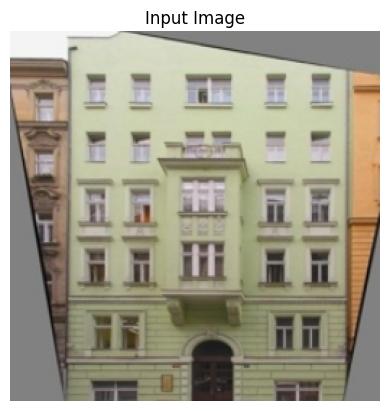

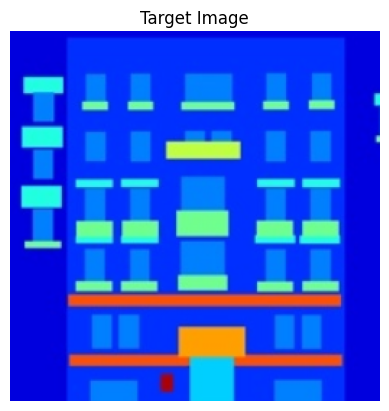

In [10]:
import matplotlib.pyplot as plt
import numpy as np

def show_tensor_image(tensor_img):
    img = tensor_img.detach().cpu().numpy()
    img = (img * 0.5) + 0.5  # denormalize from [-1, 1] to [0, 1]
    plt.imshow(np.transpose(img, (1, 2, 0)))
    plt.axis('off')

inputs, targets = next(iter(train_facades_loader))
show_tensor_image(inputs[0])
plt.title("Input Image")
plt.show()

show_tensor_image(targets[0])
plt.title("Target Image")
plt.show()


### Implementation U-Net Generator

In [11]:
class UNetDown(nn.Module):
    def __init__(self, in_channels, out_channels, normalize=True, dropout=0.0):
        super(UNetDown, self).__init__()
        layers = [nn.Conv2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False)]
        if normalize:
            layers.append(nn.BatchNorm2d(out_channels))
        layers.append(nn.LeakyReLU(0.2, inplace=True))
        if dropout:
            layers.append(nn.Dropout(dropout))
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

class UNetUp(nn.Module):
    def __init__(self, in_channels, out_channels, dropout=0.0):
        super(UNetUp, self).__init__()
        layers = [
            nn.ConvTranspose2d(in_channels, out_channels, 4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(inplace=True)
        ]
        if dropout:
            layers.append(nn.Dropout(dropout))
        self.model = nn.Sequential(*layers)

    def forward(self, x, skip_input):
        x = self.model(x)
        # Concatenate skip connection
        x = torch.cat((x, skip_input), 1)
        return x

class UNetGenerator(nn.Module):
    def __init__(self, in_channels=3, out_channels=3):
        super(UNetGenerator, self).__init__()

        # Encoder (Downsampling path)
        self.down1 = UNetDown(in_channels, 64, normalize=False)   # 256 → 128
        self.down2 = UNetDown(64, 128)                            # 128 → 64
        self.down3 = UNetDown(128, 256)                           # 64 → 32
        self.down4 = UNetDown(256, 512, dropout=0.5)              # 32 → 16
        self.down5 = UNetDown(512, 512, dropout=0.5)              # 16 → 8
        self.down6 = UNetDown(512, 512, dropout=0.5)              # 8 → 4
        self.down7 = UNetDown(512, 512, dropout=0.5)              # 4 → 2
        self.down8 = UNetDown(512, 512, normalize=False, dropout=0.5)  # 2 → 1

        # Decoder (Upsampling path)
        self.up1 = UNetUp(512, 512, dropout=0.5)
        self.up2 = UNetUp(1024, 512, dropout=0.5)
        self.up3 = UNetUp(1024, 512, dropout=0.5)
        self.up4 = UNetUp(1024, 512, dropout=0.5)
        self.up5 = UNetUp(1024, 256)
        self.up6 = UNetUp(512, 128)
        self.up7 = UNetUp(256, 64)

        # Final output layer
        self.final = nn.Sequential(
            nn.ConvTranspose2d(128, out_channels, 4, stride=2, padding=1),
            nn.Tanh()
        )

    def forward(self, x):
        # Downsampling path
        d1 = self.down1(x)
        d2 = self.down2(d1)
        d3 = self.down3(d2)
        d4 = self.down4(d3)
        d5 = self.down5(d4)
        d6 = self.down6(d5)
        d7 = self.down7(d6)
        d8 = self.down8(d7)

        # Upsampling path with skip connections
        u1 = self.up1(d8, d7)
        u2 = self.up2(u1, d6)
        u3 = self.up3(u2, d5)
        u4 = self.up4(u3, d4)
        u5 = self.up5(u4, d3)
        u6 = self.up6(u5, d2)
        u7 = self.up7(u6, d1)

        return self.final(u7)

In [12]:
gen = UNetGenerator()
x = torch.randn(1, 3, 256, 256)
y = gen(x)
print(y.shape)

torch.Size([1, 3, 256, 256])


### Patch GAN Descriminator


In [13]:
class PatchDiscriminator(nn.Module):
    def __init__(self, in_channels=3):
        super(PatchDiscriminator, self).__init__()

        def discriminator_block(in_filters, out_filters, normalize=True):
            layers = [nn.Conv2d(in_filters, out_filters, 4, stride=2, padding=1)]
            if normalize:
                layers.append(nn.BatchNorm2d(out_filters))
            layers.append(nn.LeakyReLU(0.2, inplace=True))
            return layers

        # The input has (input_image + target_image) channels
        self.model = nn.Sequential(
            *discriminator_block(in_channels * 2, 64, normalize=False),  # 256 → 128
            *discriminator_block(64, 128),                              # 128 → 64
            *discriminator_block(128, 256),                             # 64 → 32
            *discriminator_block(256, 512, normalize=False),            # 32 → 31
            nn.Conv2d(512, 1, 4, stride=1, padding=1)                   # final output patch map
        )

    def forward(self, input_image, target_image):
        # Concatenate input and target images along the channel dimension
        x = torch.cat((input_image, target_image), 1)
        return self.model(x)

In [14]:
disc = PatchDiscriminator()
input_image = torch.randn(1, 3, 256, 256)
target_image = torch.randn(1, 3, 256, 256)

output = disc(input_image, target_image)
print(output.shape)

torch.Size([1, 1, 15, 15])


## PIX 2 PIX Traning Loop

In [15]:
import copy
import torch.nn.functional as F
import torchvision.models as models

def _get_vgg_feature_extractor(device, layers=('3','8','17','26')):
    vgg = models.vgg19(pretrained=True).features.to(device).eval()
    for p in vgg.parameters():
        p.requires_grad = False

    def forward(x):
        out = []
        for idx, layer in enumerate(vgg):
            x = layer(x)
            if str(idx) in layers:
                out.append(x)
        return out

    return forward

def _normalize_for_vgg(x):
    # assumes x in [-1,1]
    x = (x + 1.0) / 2.0  # -> [0,1]
    mean = torch.tensor([0.485, 0.456, 0.406], device=x.device).view(1,3,1,1)
    std  = torch.tensor([0.229, 0.224, 0.225], device=x.device).view(1,3,1,1)
    return (x - mean) / std

def train_pix2pix(
    generator,
    discriminator,
    dataset,
    epochs=100,
    batch_size=16,
    lr=2e-4,
    beta1=0.5,
    beta2=0.999,
    lambda_l1=100,
    device=None,
    save_path='pix2pix_checkpoints',
    file_name='train',
    log_interval=100,
    use_perceptual=False,
    lambda_perc=1.0,
    use_multiscale_D=False,
    num_scales=3
):
    device = device or torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print("Using device:", device)

    os.makedirs(save_path, exist_ok=True)

    generator = generator.to(device)

    # Prepare discriminator(s)
    if use_multiscale_D:
        if isinstance(discriminator, (list, tuple, nn.ModuleList)):
            Ds = [d.to(device) for d in discriminator]
        else:
            Ds = [copy.deepcopy(discriminator).to(device) for _ in range(num_scales)]
    else:
        Ds = [discriminator.to(device)]

    loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)

    adversarial_loss = nn.BCEWithLogitsLoss().to(device)
    l1_loss = nn.L1Loss().to(device)

    if use_perceptual:
        vgg_forward = _get_vgg_feature_extractor(device)
    else:
        vgg_forward = None

    optimizer_G = optim.Adam(generator.parameters(), lr=lr, betas=(beta1, beta2))
    D_params = []
    for d in Ds:
        D_params += list(d.parameters())
    optimizer_D = optim.Adam(D_params, lr=lr, betas=(beta1, beta2))

    D_losses, G_losses, L1_losses, GAN_losses, Perc_losses = [], [], [], [], []

    for epoch in range(epochs):
        for i, (input_img, target_img) in enumerate(loader):

            input_img = input_img.to(device)
            target_img = target_img.to(device)

            # Train Generator
            optimizer_G.zero_grad()
            gen_img = generator(input_img)

            adv_loss_total = 0.0
            for scale_idx, D in enumerate(Ds):
                if use_multiscale_D and scale_idx > 0:
                    factor = 2 ** scale_idx
                    inp_scaled = F.interpolate(input_img, scale_factor=1.0 / factor, mode='bilinear')
                    gen_scaled = F.interpolate(gen_img, scale_factor=1.0 / factor, mode='bilinear')
                else:
                    inp_scaled = input_img
                    gen_scaled = gen_img

                pred_fake = D(gen_scaled, inp_scaled)

                if isinstance(pred_fake, (list, tuple)):
                    tmp = 0.0
                    for p in pred_fake:
                        valid = torch.ones_like(p, device=device)
                        tmp += adversarial_loss(p, valid)
                    adv_loss_total += tmp / len(pred_fake)
                else:
                    valid = torch.ones_like(pred_fake, device=device)
                    adv_loss_total += adversarial_loss(pred_fake, valid)

            loss_L1 = l1_loss(gen_img, target_img) * lambda_l1

            if use_perceptual:
                gen_v = _normalize_for_vgg(gen_img)
                tgt_v = _normalize_for_vgg(target_img)
                feats_g = vgg_forward(gen_v)
                feats_t = vgg_forward(tgt_v)
                perc = 0.0
                for fg, ft in zip(feats_g, feats_t):
                    perc += F.l1_loss(fg, ft)
                loss_perc = perc * lambda_perc
            else:
                loss_perc = torch.tensor(0.0, device=device)

            loss_G = adv_loss_total + loss_L1 + loss_perc
            loss_G.backward()
            optimizer_G.step()

            # Train Discriminators
            optimizer_D.zero_grad()
            loss_D_total = 0.0

            for scale_idx, D in enumerate(Ds):
                if use_multiscale_D and scale_idx > 0:
                    factor = 2 ** scale_idx
                    inp_scaled = F.interpolate(input_img, scale_factor=1.0 / factor)
                    gen_scaled = F.interpolate(gen_img.detach(), scale_factor=1.0 / factor)
                    tgt_scaled = F.interpolate(target_img, scale_factor=1.0 / factor)
                else:
                    inp_scaled = input_img
                    gen_scaled = gen_img.detach()
                    tgt_scaled = target_img

                pred_real = D(tgt_scaled, inp_scaled)
                pred_fake = D(gen_scaled, inp_scaled)

                def bce_avg(preds, labels):
                    if isinstance(preds, (list, tuple)):
                        tmp = 0.0
                        for p in preds:
                            tmp += adversarial_loss(p, labels.expand_as(p))
                        return tmp / len(preds)
                    return adversarial_loss(preds, labels)

                if isinstance(pred_real, (list, tuple)):
                    label_real = torch.ones_like(pred_real[0], device=device)
                    label_fake = torch.zeros_like(pred_real[0], device=device)
                else:
                    label_real = torch.ones_like(pred_real, device=device)
                    label_fake = torch.zeros_like(pred_real, device=device)

                loss_real = bce_avg(pred_real, label_real)
                loss_fake = bce_avg(pred_fake, label_fake)
                loss_D_total += 0.5 * (loss_real + loss_fake)

            loss_D_total.backward()
            optimizer_D.step()

            # PLOTTING: STORE LOSSES
            D_losses.append(loss_D_total.item())
            G_losses.append(loss_G.item())
            L1_losses.append(loss_L1.item())
            GAN_losses.append(adv_loss_total.item())
            Perc_losses.append(loss_perc.item())

            if i % log_interval == 0:
                log = f"[Epoch {epoch+1}/{epochs}] [Batch {i}/{len(loader)}] "
                log += f"D={loss_D_total.item():.4f} | G={loss_G.item():.4f} | L1={loss_L1.item():.4f} | GAN={adv_loss_total.item():.4f}"
                if use_perceptual:
                    log += f" | Perc={loss_perc.item():.4f}"
                print(log)

    # Save models
    torch.save(generator.state_dict(), f"{save_path}/pix2pix_generator_{file_name}.pth")
    if len(Ds) == 1:
        torch.save(Ds[0].state_dict(), f"{save_path}/pix2pix_discriminator_{file_name}.pth")
    else:
        for idx, D in enumerate(Ds):
            torch.save(D.state_dict(), f"{save_path}/pix2pix_discriminator_{file_name}_scale{idx}.pth")

    print("Saved checkpoints.")


    # PLOTTING: FINAL LOSS CURVES
    plt.figure(figsize=(12,6))
    plt.plot(G_losses, label="Generator Loss")
    plt.plot(D_losses, label="Discriminator Loss")
    plt.plot(L1_losses, label="L1 Loss")
    plt.plot(GAN_losses, label="GAN Loss")
    if use_perceptual:
        plt.plot(Perc_losses, label="Perceptual Loss")
    plt.legend()
    plt.title("Training Loss Curves")
    plt.xlabel("Iterations")
    plt.ylabel("Loss")
    plt.grid(True)
    plt.show()



## Pix 2 Pix Test Loop

In [16]:
def test_pix2pix(
    generator,
    test_dataset,
    device=None,
    num_samples=5,
    save_results=False,
    save_path='pix2pix_results'
):

    device = device or torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    generator = generator.to(device)
    generator.eval()

    os.makedirs(save_path, exist_ok=True)

    print("Evaluating Pix2Pix generator...")

    for i in range(num_samples):
        input_img, target_img = test_dataset[i]
        input_img = input_img.unsqueeze(0).to(device)
        target_img = target_img.to(device)

        with torch.no_grad():
            gen_img = generator(input_img)

        def denorm(tensor):
            tensor = (tensor + 1) / 2
            return torch.clamp(tensor, 0, 1)

        input_show = denorm(input_img.squeeze()).permute(1, 2, 0).cpu()
        gen_show = denorm(gen_img.squeeze()).permute(1, 2, 0).cpu()
        target_show = denorm(target_img).permute(1, 2, 0).cpu()

        # Plot
        fig, axes = plt.subplots(1, 3, figsize=(12, 5))
        titles = ['Input', 'Generated', 'Target']
        images = [input_show, gen_show, target_show]

        for ax, img, title in zip(axes, images, titles):
            ax.imshow(img)
            ax.set_title(title)
            ax.axis('off')

        plt.tight_layout()
        plt.show()

        if save_results:
            plt.savefig(os.path.join(save_path, f"result_{i+1}.png"))
            print(f"Saved result_{i+1}.png")

    print("Testing complete.")

## Evaluate model


In [17]:
!pip install pytorch-ssim piq

In [18]:
import torch
import numpy as np
import piq
from tqdm.auto import tqdm
import torch.nn.functional as F
import torchvision.models as models

def evaluate_pix2pix_metrics(generator, test_dataset, device=None, num_samples=None, num_workers=2, feat_resize=224):
    device = device or torch.device('cuda' if torch.cuda.is_available() else 'cpu')
    generator = generator.to(device)
    generator.eval()

    psnr_vals = []
    ssim_vals = []
    real_imgs = []
    fake_imgs = []

    loader = torch.utils.data.DataLoader(
        test_dataset,
        batch_size=1,
        shuffle=False,
        num_workers=num_workers
    )

    def _unpack_batch(batch):
        if isinstance(batch, (list, tuple)) and len(batch) >= 2:
            return batch[0], batch[1]
        if isinstance(batch, dict):
            for k_in, k_t in (('A','B'), ('input','target'), ('img','gt'), ('image','label')):
                if k_in in batch and k_t in batch:
                    return batch[k_in], batch[k_t]
            items = list(batch.values())
            if len(items) >= 2:
                return items[0], items[1]
        raise ValueError("Couldn't unpack dataset batch. Expected (input, target) or dict with 'A'/'B'")

    def denorm(x):
        x = x.float()
        if x.min() < 0:
            return (x + 1.0) / 2.0
        return x

    seen = 0
    for batch in tqdm(loader, desc="Evaluating", leave=False):
        if num_samples is not None and seen >= num_samples:
            break

        try:
            inp, target = _unpack_batch(batch)
        except ValueError as e:
            raise RuntimeError(f"evaluate_pix2pix_metrics: cannot unpack dataset batch: {e}")

        inp = inp.to(device)
        target = target.to(device)

        with torch.no_grad():
            gen_out = generator(inp)

        if isinstance(gen_out, (tuple, list)):
            gen_img = gen_out[0]
        elif isinstance(gen_out, dict):
            for k in ('out', 'fake', 'pred', 'generated'):
                if k in gen_out:
                    gen_img = gen_out[k]
                    break
            else:
                gen_img = next(iter(gen_out.values()))
        else:
            gen_img = gen_out

        if gen_img.dim() == 3:
            gen_img = gen_img.unsqueeze(0)
        if target.dim() == 3:
            target = target.unsqueeze(0)

        gen_img = torch.clamp(denorm(gen_img), 0.0, 1.0).cpu()
        target_img = torch.clamp(denorm(target), 0.0, 1.0).cpu()

        if gen_img.shape[1] != target_img.shape[1]:
            if gen_img.shape[1] == 1 and target_img.shape[1] == 3:
                gen_img = gen_img.repeat(1,3,1,1)
            elif gen_img.shape[1] == 3 and target_img.shape[1] == 1:
                target_img = target_img.repeat(1,3,1,1)
            else:
                raise RuntimeError(f"Channel mismatch: gen {gen_img.shape}, target {target_img.shape}")

        try:
            psnr_val = float(piq.psnr(gen_img, target_img, data_range=1.0).item())
            ssim_val = float(piq.ssim(gen_img, target_img, data_range=1.0).item())
        except Exception as e:
            raise RuntimeError(f"piq metric error: {e}. gen_img.shape={gen_img.shape}, target.shape={target_img.shape}")

        psnr_vals.append(psnr_val)
        ssim_vals.append(ssim_val)

        fake_imgs.append(gen_img.squeeze(0))   # (C,H,W)
        real_imgs.append(target_img.squeeze(0))

        seen += 1

    if len(psnr_vals) == 0:
        raise RuntimeError("No samples evaluated (psnr list empty). Check test_dataset and num_samples parameters.")

    # STACK images into (N,C,H,W)
    fake_tensor = torch.stack(fake_imgs, dim=0)   # CPU float in [0,1]
    real_tensor = torch.stack(real_imgs, dim=0)

    # Use pretrained ResNet-50 and take avgpool features (shape: N x 2048)
    # Resize input to feat_resize (default 224) and normalize with ImageNet stats.
    resnet = models.resnet50(pretrained=True)
    resnet = resnet.to(device)
    resnet.eval()
    # remove final fc: we'll use avgpool output
    # create a small wrapper to return the avgpool features flattened
    class ResNetFeatureExtractor(torch.nn.Module):
        def __init__(self, base):
            super().__init__()
            # take everything except final fc
            self.base = torch.nn.Sequential(
                base.conv1, base.bn1, base.relu, base.maxpool,
                base.layer1, base.layer2, base.layer3, base.layer4,
                base.avgpool  # produces (N,2048,1,1)
            )
        def forward(self, x):
            x = self.base(x)
            x = x.view(x.size(0), -1)  # (N,2048)
            return x

    feat_extractor = ResNetFeatureExtractor(resnet).to(device)
    feat_extractor.eval()

    # ImageNet normalization
    imagenet_mean = torch.tensor([0.485, 0.456, 0.406], device=device).view(1,3,1,1)
    imagenet_std  = torch.tensor([0.229, 0.224, 0.225], device=device).view(1,3,1,1)

    # compute features in batches to avoid OOM (use batch size up to 32)
    def compute_features(imgs_cpu, batch_size=16):
        imgs = imgs_cpu.to(device)
        N = imgs.shape[0]
        feats = []
        with torch.no_grad():
            for i in range(0, N, batch_size):
                b = imgs[i:i+batch_size]
                # ensure 3 channels
                if b.shape[1] == 1:
                    b = b.repeat(1,3,1,1)
                # resize to feat_resize
                b = F.interpolate(b, size=(feat_resize, feat_resize), mode='bilinear', align_corners=False)
                # normalize
                b = (b - imagenet_mean) / imagenet_std
                f = feat_extractor(b)  # (bs, 2048)
                feats.append(f.cpu())
        feats = torch.cat(feats, dim=0)  # (N,2048)
        return feats

    fake_feats = compute_features(fake_tensor, batch_size=16)
    real_feats = compute_features(real_tensor, batch_size=16)

    # Now piq.FID expects (N, D) 2-D tensors
    fid_metric = piq.FID()
    # convert to float64 because piq uses double internally for statistics
    fid_val = float(fid_metric(fake_feats.double(), real_feats.double()).item())

    psnr_mean = float(np.mean(psnr_vals))
    ssim_mean = float(np.mean(ssim_vals))

    print("Evaluation Metrics:")
    print(f"PSNR: {psnr_mean:.4f}")
    print(f"SSIM: {ssim_mean:.4f}")
    print(f"FID:  {fid_val:.4f}")

    return {"PSNR": psnr_mean, "SSIM": ssim_mean, "FID": fid_val}


c:\Users\Ragha\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## Facades dataset

### Model trained using Adversarial loss


Using device: cuda
[Epoch 1/200] [Batch 0/25] D=0.6989 | G=76.9907 | L1=76.2536 | GAN=0.7371
[Epoch 2/200] [Batch 0/25] D=0.1596 | G=53.2818 | L1=50.3650 | GAN=2.9168
[Epoch 3/200] [Batch 0/25] D=0.2593 | G=48.2039 | L1=46.8976 | GAN=1.3062
[Epoch 4/200] [Batch 0/25] D=0.2608 | G=39.0460 | L1=36.7383 | GAN=2.3078
[Epoch 5/200] [Batch 0/25] D=0.2382 | G=45.1653 | L1=43.3090 | GAN=1.8563
[Epoch 6/200] [Batch 0/25] D=0.0835 | G=45.3125 | L1=42.8551 | GAN=2.4574
[Epoch 7/200] [Batch 0/25] D=0.1518 | G=37.9865 | L1=35.9173 | GAN=2.0692
[Epoch 8/200] [Batch 0/25] D=0.0550 | G=47.1006 | L1=44.0329 | GAN=3.0677
[Epoch 9/200] [Batch 0/25] D=0.1114 | G=41.3099 | L1=39.3366 | GAN=1.9732
[Epoch 10/200] [Batch 0/25] D=1.4677 | G=37.5410 | L1=37.4073 | GAN=0.1336
[Epoch 11/200] [Batch 0/25] D=0.1897 | G=36.7626 | L1=34.6303 | GAN=2.1323
[Epoch 12/200] [Batch 0/25] D=0.0537 | G=42.5763 | L1=39.6435 | GAN=2.9328
[Epoch 13/200] [Batch 0/25] D=0.1551 | G=39.4214 | L1=37.4556 | GAN=1.9659
[Epoch 14/200] 

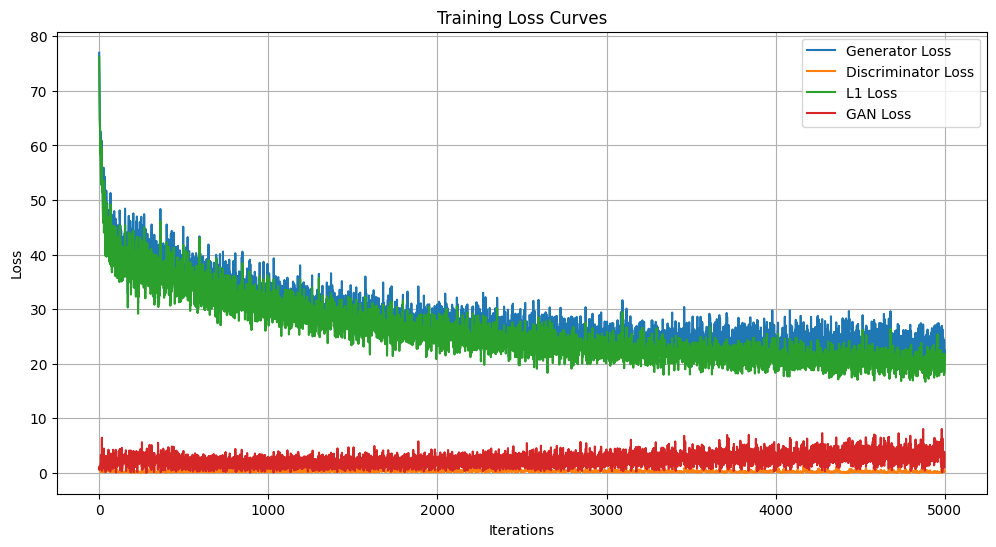

In [19]:
gen = UNetGenerator()
disc = PatchDiscriminator()

# Train Adversarial loss + single patchGan
train_pix2pix(
    generator=gen,
    discriminator=disc,
    dataset=train_facades_dataset,
    epochs=200,
    batch_size=16,
    lr=2e-4,
    beta1=0.5,
    beta2=0.999,
    save_path='pix2pix_checkpoints',
    file_name='facades_adv'
)

In [20]:
# Pix 2 Pix Adversarial model load
gen = UNetGenerator()
checkpoint_path = "pix2pix_checkpoints/pix2pix_generator_facades_adv.pth"
map_loc = 'cuda' if torch.cuda.is_available() else 'cpu'
gen.load_state_dict(torch.load(checkpoint_path, map_location=map_loc))
gen.eval()

facades_path = download_pix2pix_dataset("facades")
test_dataset = Pix2PixDataset(facades_path, mode='val')

Dataset 'facades' already extracted at datasets\facades


C:\Users\Ragha\AppData\Local\Temp\ipykernel_31340\486876560.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen.load_state_dict(torch.load(checkpoint_path, map_location=

Evaluating Pix2Pix generator...


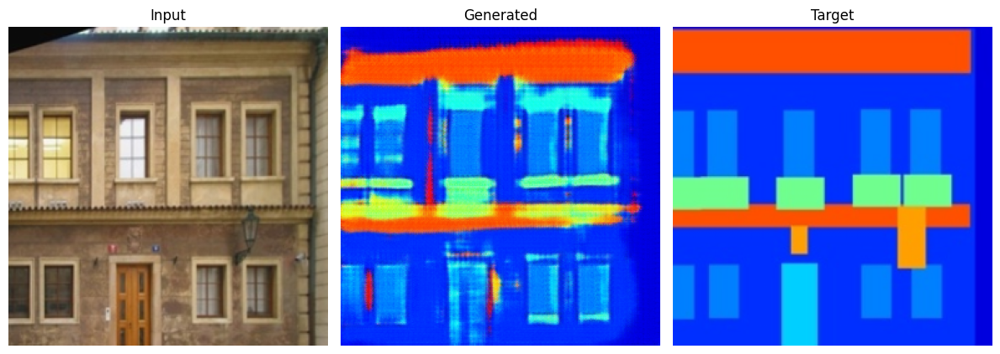

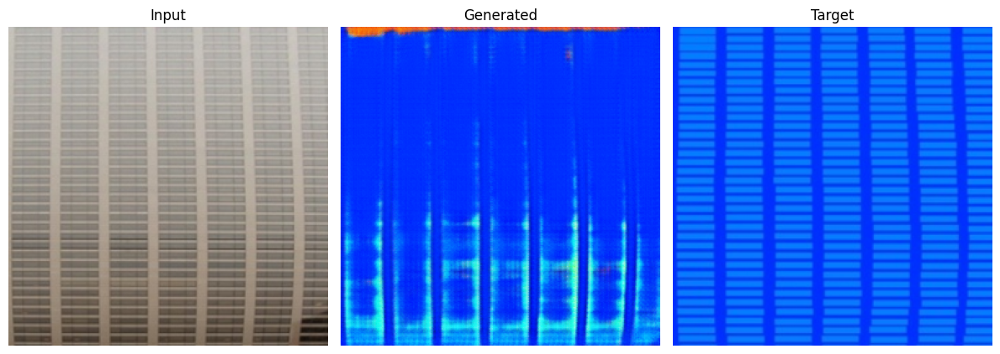

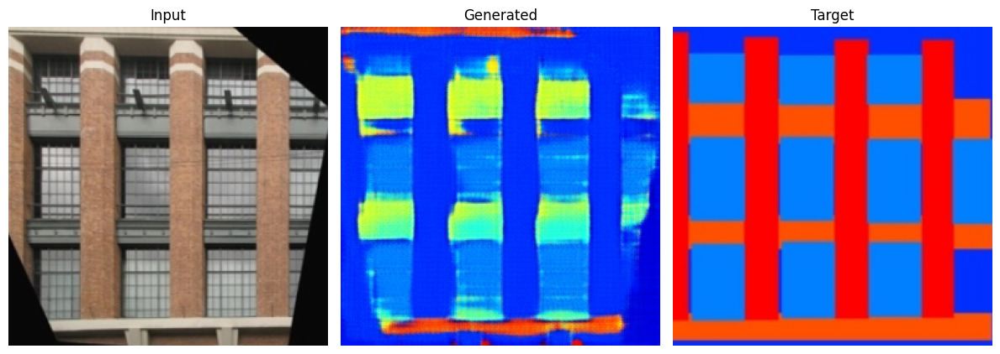

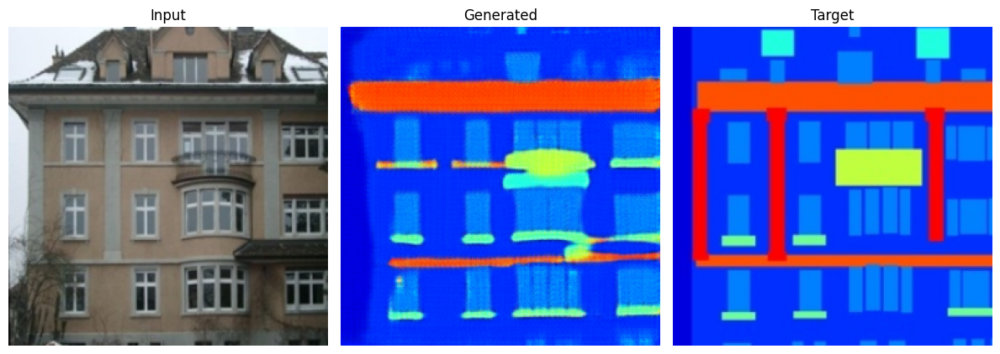

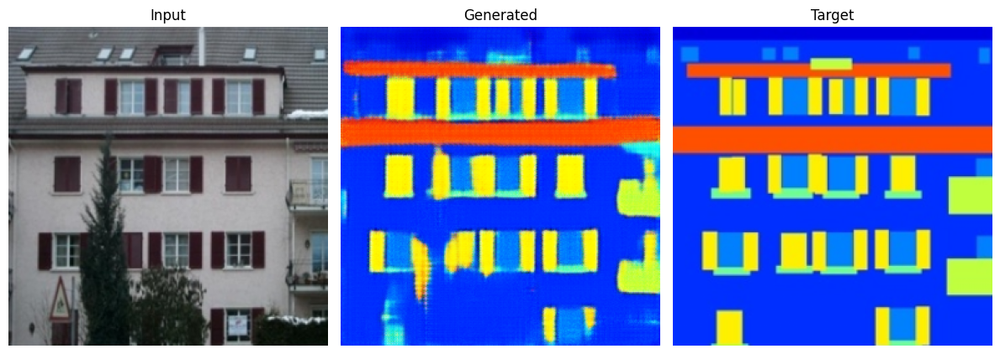

Testing complete.


In [21]:
# Test Pix 2 Pix Adversarial model
test_pix2pix(generator=gen, test_dataset=test_dataset, num_samples=5, save_results=False)

In [23]:
# Evaluate Pix 2 Pix Adversarial model
metrics = evaluate_pix2pix_metrics(generator=gen, test_dataset=test_dataset, num_workers=0 ,num_samples=100)
print(metrics)

c:\Users\Ragha\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
c:\Users\Ragha\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Evaluation Metrics:
PSNR: 11.2153
SSIM: 0.4549
FID:  417.5489
{'PSNR': 11.21527413368225, 'SSIM': 0.45488317027688024, 'FID': 417.54893800963924}


### Model Trained using VGG perceptual loss and Multi PatchGan Discriminators

Using device: cuda


c:\Users\Ragha\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG19_Weights.IMAGENET1K_V1`. You can also use `weights=VGG19_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


[Epoch 1/200] [Batch 0/25] D=1.3911 | G=53.6989 | L1=45.3802 | GAN=1.2658 | Perc=7.0529
[Epoch 1/200] [Batch 20/25] D=0.4978 | G=41.8506 | L1=30.1421 | GAN=6.4486 | Perc=5.2599
[Epoch 2/200] [Batch 0/25] D=0.5041 | G=43.9235 | L1=29.9065 | GAN=8.4967 | Perc=5.5203
[Epoch 2/200] [Batch 20/25] D=0.4531 | G=35.9375 | L1=27.2686 | GAN=3.0278 | Perc=5.6411
[Epoch 3/200] [Batch 0/25] D=0.4424 | G=35.5993 | L1=26.9725 | GAN=3.1737 | Perc=5.4531
[Epoch 3/200] [Batch 20/25] D=0.7569 | G=30.6603 | L1=23.3457 | GAN=1.8744 | Perc=5.4401
[Epoch 4/200] [Batch 0/25] D=0.5113 | G=28.5750 | L1=21.2708 | GAN=2.5179 | Perc=4.7864
[Epoch 4/200] [Batch 20/25] D=0.8773 | G=27.5483 | L1=20.5613 | GAN=1.7558 | Perc=5.2312
[Epoch 5/200] [Batch 0/25] D=0.9037 | G=27.9814 | L1=21.5945 | GAN=1.2432 | Perc=5.1437
[Epoch 5/200] [Batch 20/25] D=0.8274 | G=28.7848 | L1=20.6504 | GAN=3.2086 | Perc=4.9258
[Epoch 6/200] [Batch 0/25] D=1.1149 | G=30.8632 | L1=21.8141 | GAN=4.1444 | Perc=4.9047
[Epoch 6/200] [Batch 20/25]

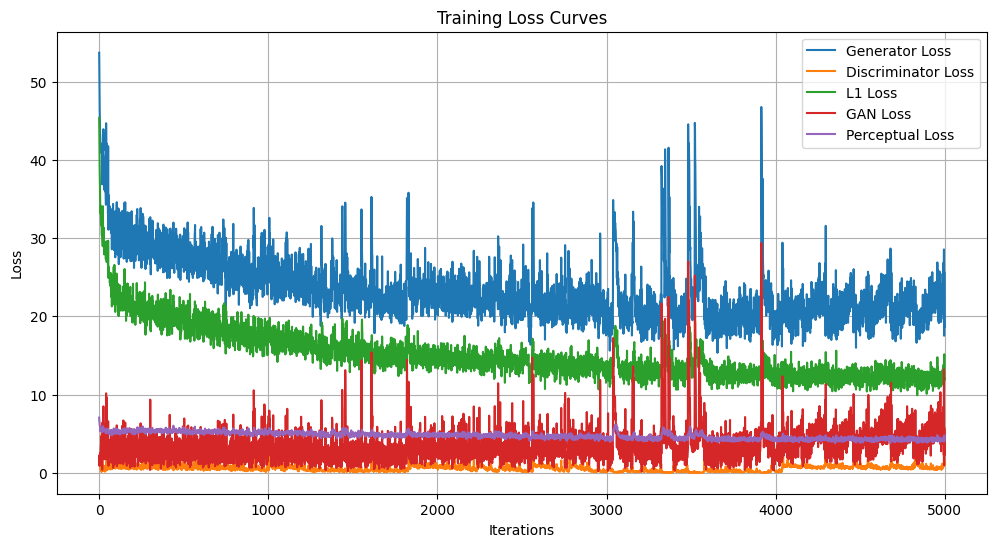

In [24]:
gen = UNetGenerator()
disc = PatchDiscriminator()

# Train VGG Perceptual loss + 2 scale patchGan
train_pix2pix(
    generator=gen,
    discriminator=disc,
    dataset=train_facades_dataset,

    # training schedule
    epochs=200,
    batch_size=16,
    lr=2e-4,
    beta1=0.5,
    beta2=0.999,

    # losses
    lambda_l1=50,
    use_perceptual=True,
    lambda_perc=1.0,

    # discriminator
    use_multiscale_D=True,
    num_scales=2,

    # other defaults
    device=None,
    save_path='pix2pix_checkpoints',
    file_name='facades_vgg_perc_multi_patchgan',
    log_interval=20
)

In [25]:
# Optional: load pre-trained Facades generator + discriminator from local checkpoints
gen = UNetGenerator()
disc = PatchDiscriminator()

checkpoint_G = "pix2pix_checkpoints/pix2pix_generator_facades_vgg_perc_multi_patchgan.pth"
checkpoint_D = "pix2pix_checkpoints/pix2pix_discriminator_facades_vgg_perc_multi_patchgan_scale0.pth"

map_loc = 'cuda' if torch.cuda.is_available() else 'cpu'
gen.load_state_dict(torch.load(checkpoint_G, map_location=map_loc))
disc.load_state_dict(torch.load(checkpoint_D, map_location=map_loc))

gen.eval()
disc.eval()

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
gen.to(device)
disc.to(device)

C:\Users\Ragha\AppData\Local\Temp\ipykernel_31340\3741217820.py:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen.load_state_dict(torch.load(checkpoint_G, map_location=ma

PatchDiscriminator(
  (model): Sequential(
    (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
    (10): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

Dataset 'facades' already extracted at datasets\facades
Evaluating Pix2Pix generator...


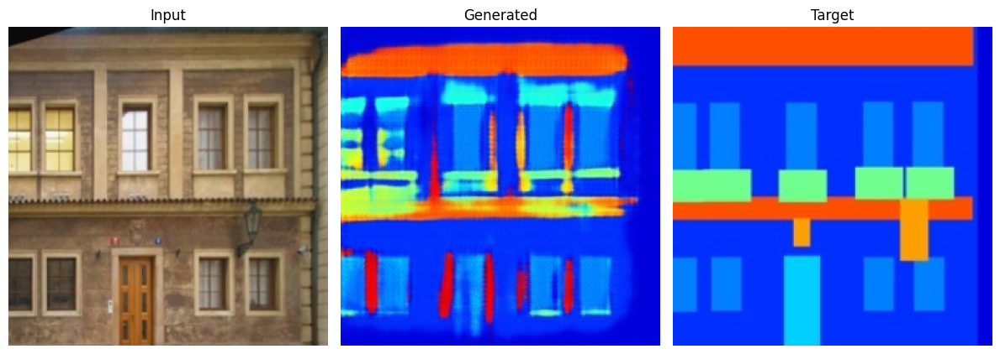

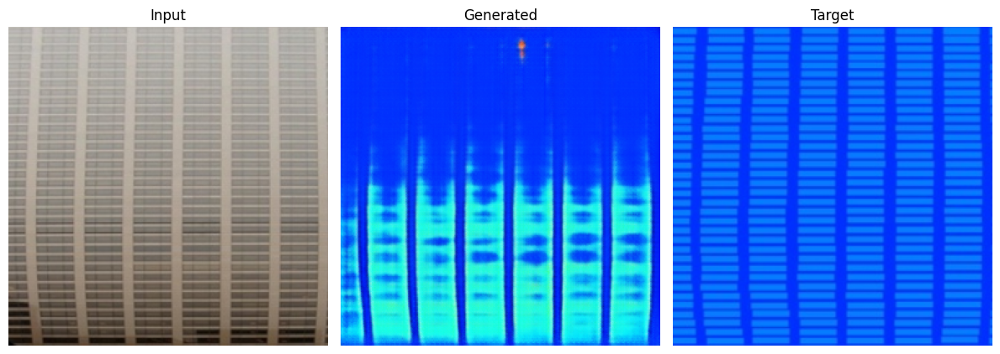

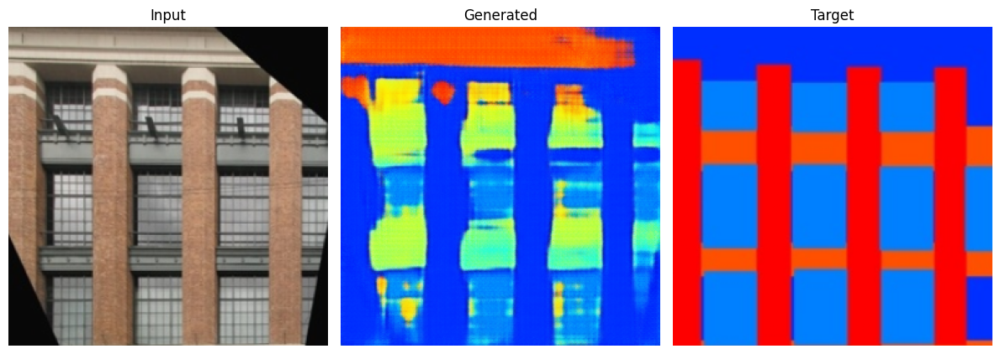

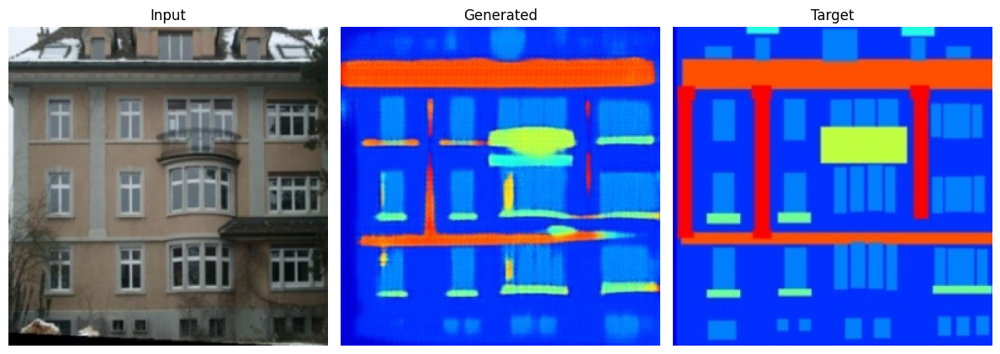

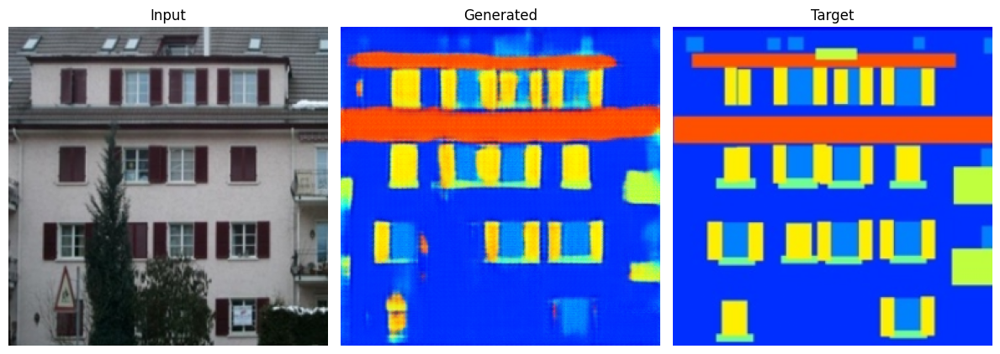

Testing complete.


In [26]:
facades_path = download_pix2pix_dataset("facades")
test_dataset = Pix2PixDataset(facades_path, mode='val')
test_pix2pix(generator=gen, test_dataset=test_dataset, num_samples=5, save_results=False)

In [27]:
## Pix 2 Pix with VGG Perceptual loss and Multi patch gan evaluation
metrics = evaluate_pix2pix_metrics(generator=gen, test_dataset=test_dataset, num_workers=0, num_samples=100)
print(metrics)

Evaluation Metrics:
PSNR: 10.8262
SSIM: 0.4423
FID:  426.6674
{'PSNR': 10.826231708526612, 'SSIM': 0.4423476278036833, 'FID': 426.66736360613197}


## Cityscapes dataset

In [28]:
## cityscapes Dataset
dataset_path = download_pix2pix_dataset("cityscapes")
train_cityscapes_dataset = Pix2PixDataset(dataset_path, mode='train')
train_cityscapes_loader = DataLoader(train_cityscapes_dataset, batch_size=16, shuffle=True)

Download complete: datasets\cityscapes.tar.gz
Extracting...
Extraction complete. Extracted to: datasets\cityscapes


### Model trained using Adversarial loss


Using device: cuda
[Epoch 1/200] [Batch 0/47] D=0.6982 | G=62.2493 | L1=61.5739 | GAN=0.6754
[Epoch 1/200] [Batch 20/47] D=0.2439 | G=29.5210 | L1=27.9020 | GAN=1.6190
[Epoch 1/200] [Batch 40/47] D=0.1208 | G=24.8665 | L1=22.4564 | GAN=2.4101
[Epoch 2/200] [Batch 0/47] D=0.3467 | G=25.4353 | L1=23.4155 | GAN=2.0198
[Epoch 2/200] [Batch 20/47] D=0.6849 | G=23.2000 | L1=22.5639 | GAN=0.6361
[Epoch 2/200] [Batch 40/47] D=0.4598 | G=20.4580 | L1=19.5022 | GAN=0.9558
[Epoch 3/200] [Batch 0/47] D=0.4391 | G=21.0809 | L1=19.3317 | GAN=1.7491
[Epoch 3/200] [Batch 20/47] D=1.0712 | G=22.9470 | L1=18.8771 | GAN=4.0699
[Epoch 3/200] [Batch 40/47] D=0.6208 | G=19.4517 | L1=18.6516 | GAN=0.8001
[Epoch 4/200] [Batch 0/47] D=0.4654 | G=21.4188 | L1=19.8016 | GAN=1.6172
[Epoch 4/200] [Batch 20/47] D=0.3307 | G=18.9034 | L1=17.3900 | GAN=1.5134
[Epoch 4/200] [Batch 40/47] D=0.3774 | G=19.9204 | L1=18.1741 | GAN=1.7464
[Epoch 5/200] [Batch 0/47] D=0.1938 | G=19.7791 | L1=18.1016 | GAN=1.6775
[Epoch 5/20

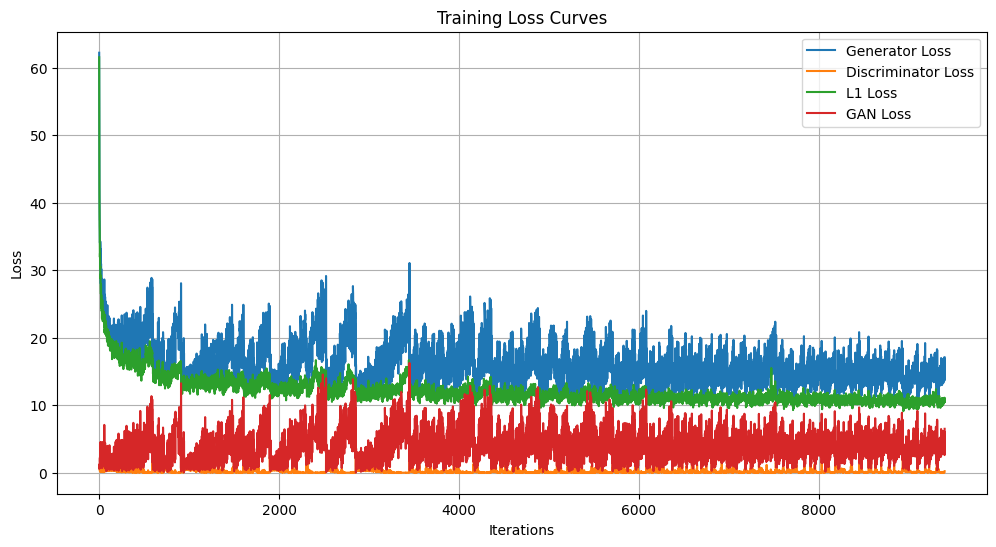

In [29]:
gen = UNetGenerator()
disc = PatchDiscriminator()

# Train Adversarial loss + single patchGan
train_pix2pix(
    generator=gen,
    discriminator=disc,
    dataset=train_cityscapes_dataset,
    epochs=200,
    batch_size=64,
    lr=2e-4,
    beta1=0.5,
    beta2=0.999,
    save_path='pix2pix_checkpoints',
    file_name='cityscapes_adv',
    log_interval=20
)

In [30]:
# Pix 2 Pix Adversarial model load
gen = UNetGenerator()
checkpoint_path = "pix2pix_checkpoints/pix2pix_generator_cityscapes_adv.pth"
map_loc = 'cuda' if torch.cuda.is_available() else 'cpu'
gen.load_state_dict(torch.load(checkpoint_path, map_location=map_loc))
gen.eval()

cityscapes_path = download_pix2pix_dataset("cityscapes")
test_dataset = Pix2PixDataset(cityscapes_path, mode='val')

Dataset 'cityscapes' already extracted at datasets\cityscapes


C:\Users\Ragha\AppData\Local\Temp\ipykernel_31340\2023261489.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen.load_state_dict(torch.load(checkpoint_path, map_location

Evaluating Pix2Pix generator...


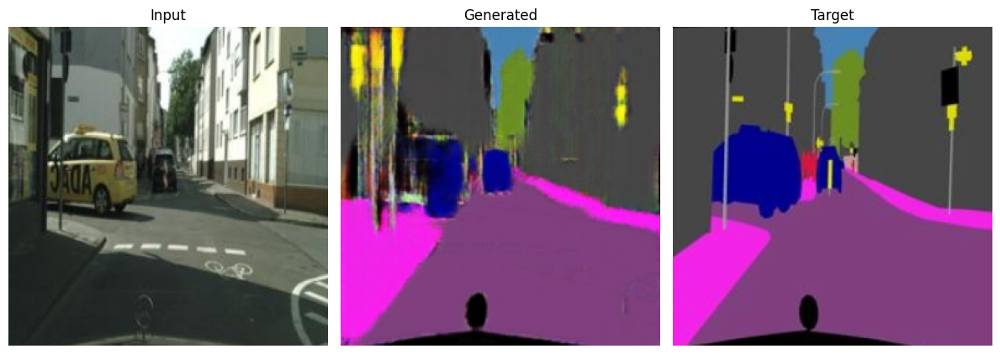

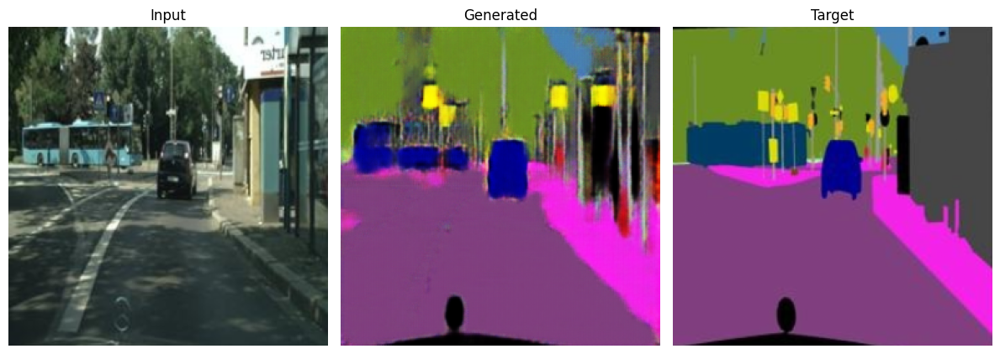

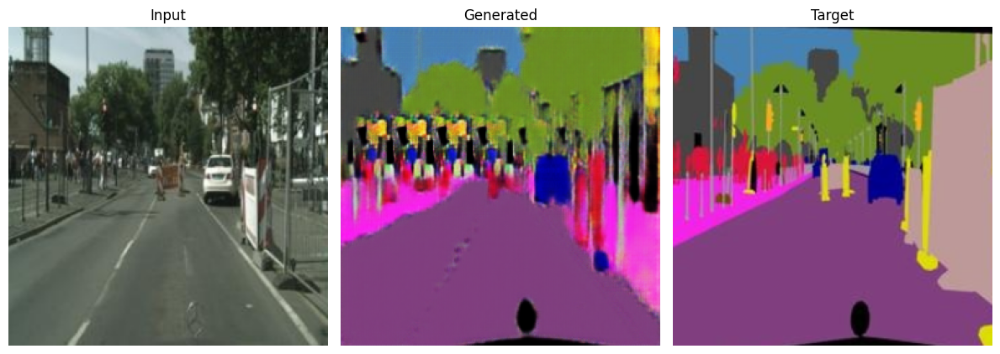

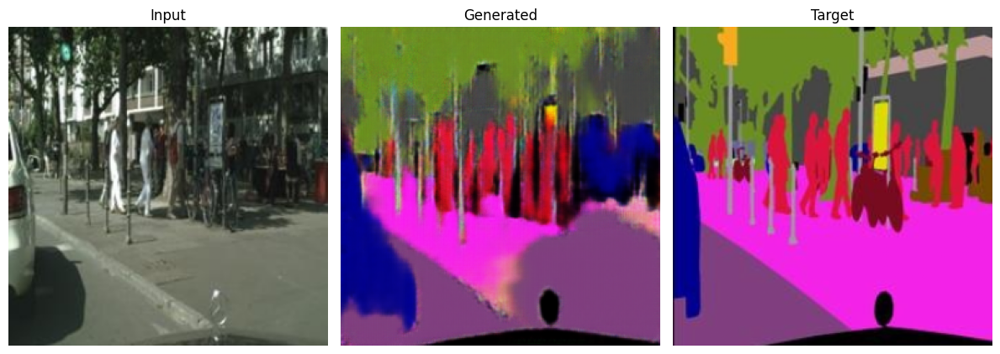

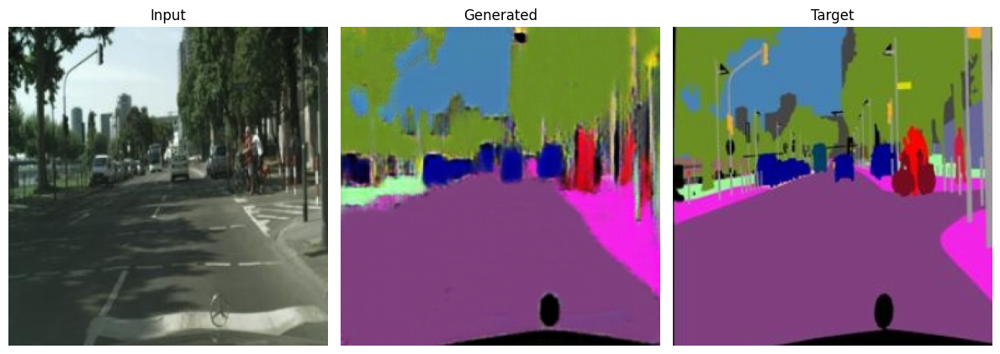

Testing complete.


In [31]:
# Test Pix 2 Pix Adversarial model
test_pix2pix(generator=gen, test_dataset=test_dataset, num_samples=5, save_results=False)

In [32]:
# Evaluate Pix 2 Pix Adversarial model
metrics = evaluate_pix2pix_metrics(generator=gen, test_dataset=test_dataset, num_workers=0, num_samples=500)
print(metrics)

Evaluation Metrics:
PSNR: 18.2748
SSIM: 0.6861
FID:  130.2564
{'PSNR': 18.274781675338744, 'SSIM': 0.686139571249485, 'FID': 130.25639909790362}


### Model Trained using VGG perceptual loss and Multi PatchGan Discriminators

Using device: cuda
[Epoch 1/200] [Batch 0/47] D=1.3919 | G=36.5455 | L1=29.7526 | GAN=1.3326 | Perc=5.4604
[Epoch 1/200] [Batch 20/47] D=1.0725 | G=20.2963 | L1=15.1841 | GAN=1.8532 | Perc=3.2590
[Epoch 1/200] [Batch 40/47] D=0.7697 | G=19.8603 | L1=13.3348 | GAN=3.3422 | Perc=3.1834
[Epoch 2/200] [Batch 0/47] D=1.5301 | G=17.2403 | L1=13.3274 | GAN=0.7304 | Perc=3.1825
[Epoch 2/200] [Batch 20/47] D=1.0381 | G=16.6011 | L1=11.8423 | GAN=1.7187 | Perc=3.0401
[Epoch 2/200] [Batch 40/47] D=1.1532 | G=16.2482 | L1=10.7137 | GAN=2.6332 | Perc=2.9013
[Epoch 3/200] [Batch 0/47] D=0.8841 | G=14.5424 | L1=10.1199 | GAN=1.5130 | Perc=2.9095
[Epoch 3/200] [Batch 20/47] D=1.2081 | G=14.6688 | L1=10.0778 | GAN=1.7886 | Perc=2.8024
[Epoch 3/200] [Batch 40/47] D=1.4424 | G=14.5989 | L1=9.8950 | GAN=1.7539 | Perc=2.9499
[Epoch 4/200] [Batch 0/47] D=0.9244 | G=14.2898 | L1=9.7568 | GAN=1.7757 | Perc=2.7574
[Epoch 4/200] [Batch 20/47] D=0.9024 | G=14.7789 | L1=9.6661 | GAN=2.2147 | Perc=2.8981
[Epoch 4/

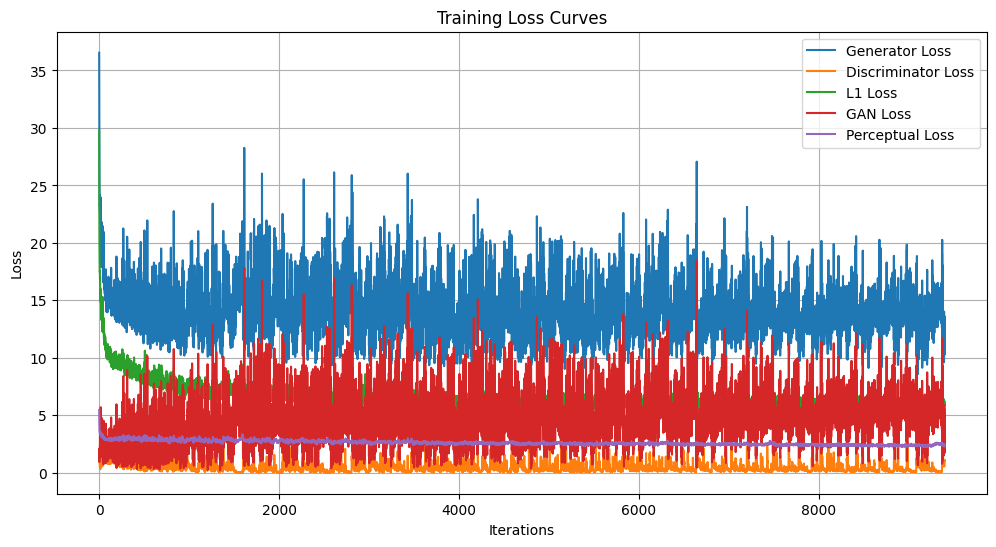

In [33]:
gen = UNetGenerator()
disc = PatchDiscriminator()

# Train VGG Perceptual loss + 2 scale patchGan
train_pix2pix(
    generator=gen,
    discriminator=disc,
    dataset=train_cityscapes_dataset,

    # training schedule
    epochs=200,
    batch_size=64,
    lr=2e-4,
    beta1=0.5,
    beta2=0.999,

    # losses
    lambda_l1=50,
    use_perceptual=True,
    lambda_perc=1.0,

    # discriminator
    use_multiscale_D=True,
    num_scales=2,

    # other defaults
    device=None,
    save_path='pix2pix_checkpoints',
    file_name='cityscapes_vgg_perc_multi_patchgan',
    log_interval=20
)

In [34]:
# Optional: load pre-trained cityscapes generator + discriminator from local checkpoints
gen = UNetGenerator()
disc = PatchDiscriminator()

checkpoint_G = "pix2pix_checkpoints/pix2pix_generator_cityscapes_vgg_perc_multi_patchgan.pth"
checkpoint_D = "pix2pix_checkpoints/pix2pix_discriminator_cityscapes_vgg_perc_multi_patchgan_scale0.pth"

map_loc = 'cuda' if torch.cuda.is_available() else 'cpu'
gen.load_state_dict(torch.load(checkpoint_G, map_location=map_loc))
disc.load_state_dict(torch.load(checkpoint_D, map_location=map_loc))

gen.eval()
disc.eval()

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
gen.to(device)
disc.to(device)

C:\Users\Ragha\AppData\Local\Temp\ipykernel_31340\2468094444.py:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen.load_state_dict(torch.load(checkpoint_G, map_location=ma

PatchDiscriminator(
  (model): Sequential(
    (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
    (10): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

Dataset 'cityscapes' already extracted at datasets\cityscapes
Evaluating Pix2Pix generator...


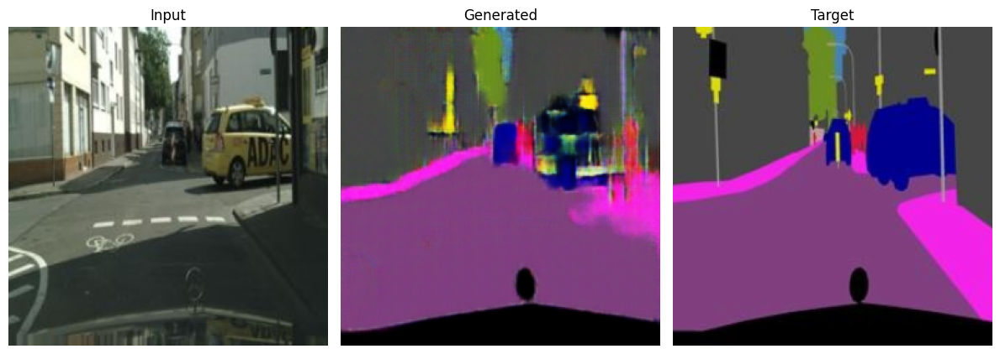

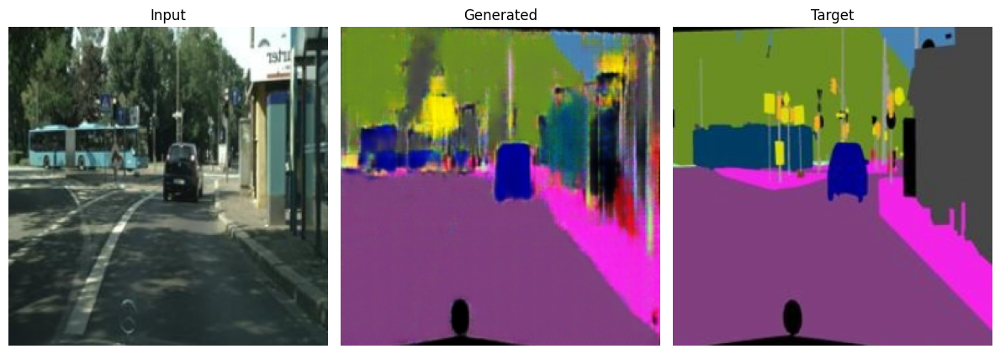

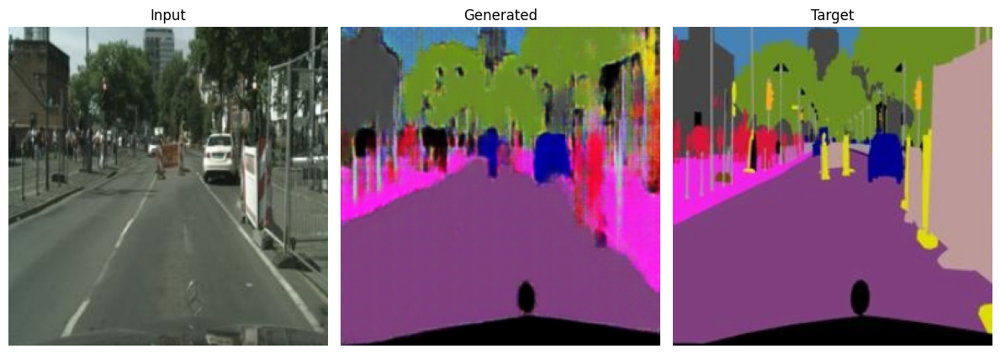

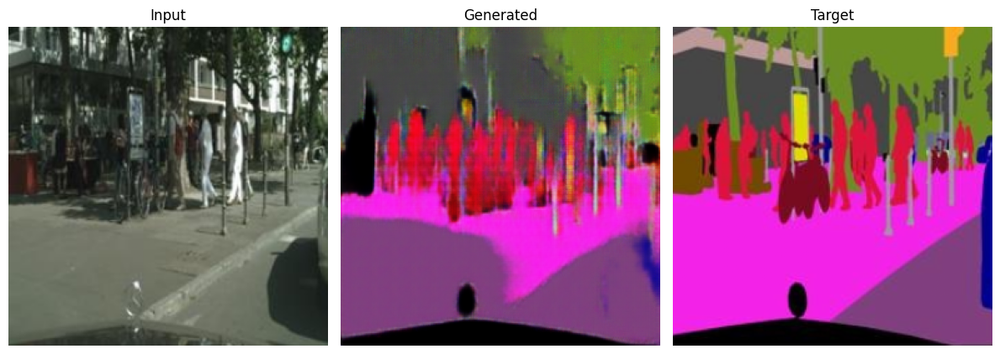

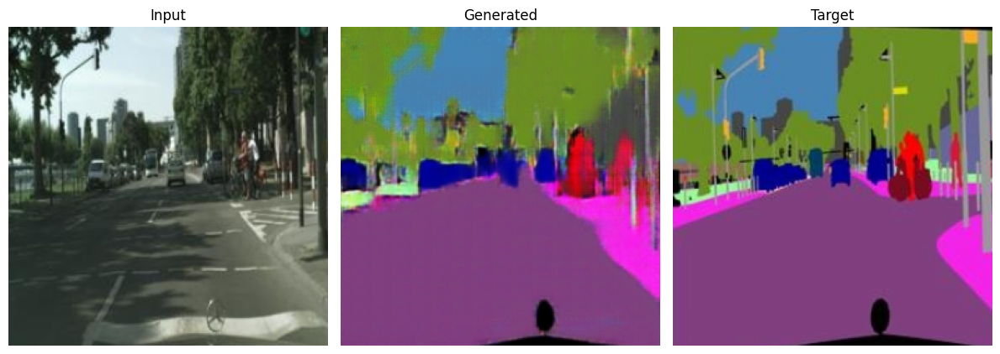

Testing complete.


In [35]:
cityscapes_path = download_pix2pix_dataset("cityscapes")
test_dataset = Pix2PixDataset(cityscapes_path, mode='val')
test_pix2pix(generator=gen, test_dataset=test_dataset, num_samples=5, save_results=False)

In [36]:
## Pix 2 Pix with VGG Perceptual loss and Multi patch gan evaluation
metrics = evaluate_pix2pix_metrics(generator=gen, test_dataset=test_dataset, num_workers=0, num_samples=500)
print(metrics)

Evaluation Metrics:
PSNR: 17.9539
SSIM: 0.6794
FID:  140.7799
{'PSNR': 17.95386458969116, 'SSIM': 0.679352024435997, 'FID': 140.7799251127116}


## Maps dataset

In [37]:
## Maps Dataset
dataset_path = download_pix2pix_dataset("maps")
train_maps_dataset = Pix2PixDataset(dataset_path, mode='train')
train_maps_loader = DataLoader(train_maps_dataset, batch_size=16, shuffle=True)

Download complete: datasets\maps.tar.gz
Extracting...
Extraction complete. Extracted to: datasets\maps


### Model trained using Adversarial loss


Using device: cuda
[Epoch 1/200] [Batch 0/18] D=0.6961 | G=72.7164 | L1=72.0132 | GAN=0.7032
[Epoch 1/200] [Batch 5/18] D=0.3760 | G=40.3303 | L1=39.4509 | GAN=0.8794
[Epoch 1/200] [Batch 10/18] D=0.0582 | G=30.6061 | L1=27.6157 | GAN=2.9903
[Epoch 1/200] [Batch 15/18] D=0.1558 | G=24.2085 | L1=19.9965 | GAN=4.2120
[Epoch 2/200] [Batch 0/18] D=0.2162 | G=22.7920 | L1=18.7163 | GAN=4.0757
[Epoch 2/200] [Batch 5/18] D=0.0301 | G=19.6706 | L1=15.8028 | GAN=3.8679
[Epoch 2/200] [Batch 10/18] D=0.1164 | G=17.1914 | L1=13.5372 | GAN=3.6541
[Epoch 2/200] [Batch 15/18] D=0.0098 | G=18.7469 | L1=13.4214 | GAN=5.3254
[Epoch 3/200] [Batch 0/18] D=0.0463 | G=16.9238 | L1=13.1693 | GAN=3.7546
[Epoch 3/200] [Batch 5/18] D=1.2288 | G=18.1497 | L1=13.9270 | GAN=4.2227
[Epoch 3/200] [Batch 10/18] D=0.2015 | G=13.5997 | L1=11.4250 | GAN=2.1747
[Epoch 3/200] [Batch 15/18] D=0.1401 | G=14.2042 | L1=11.8113 | GAN=2.3929
[Epoch 4/200] [Batch 0/18] D=0.3278 | G=15.7471 | L1=13.6919 | GAN=2.0552
[Epoch 4/200]

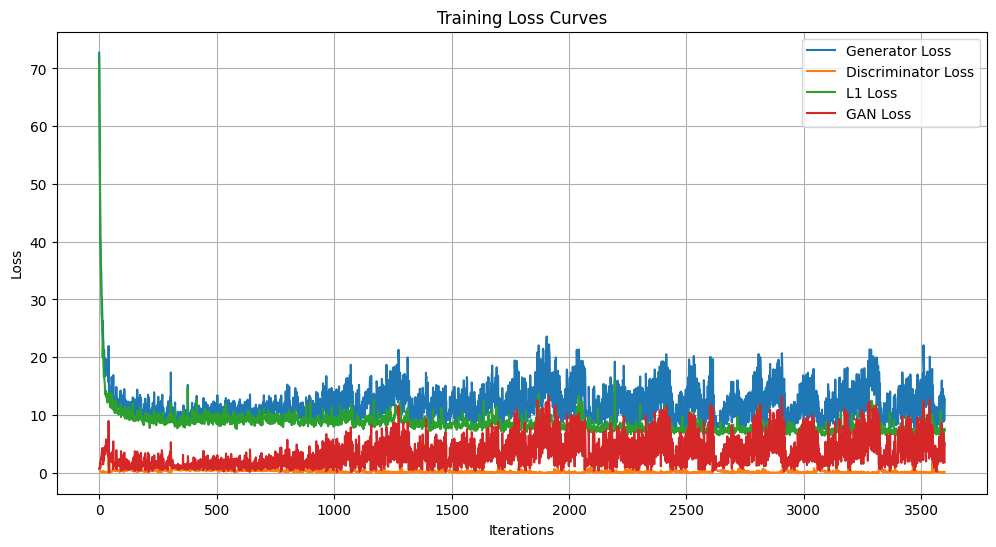

In [38]:
gen = UNetGenerator()
disc = PatchDiscriminator()

# Train Adversarial loss + single patchGan
train_pix2pix(
    generator=gen,
    discriminator=disc,
    dataset=train_maps_dataset,
    epochs=200,
    batch_size=64,
    lr=2e-4,
    beta1=0.5,
    beta2=0.999,
    save_path='pix2pix_checkpoints',
    file_name='maps_adv',
    log_interval=5
)

In [39]:
# Pix 2 Pix Adversarial model load
gen = UNetGenerator()
checkpoint_path = "pix2pix_checkpoints/pix2pix_generator_maps_adv.pth"
map_loc = 'cuda' if torch.cuda.is_available() else 'cpu'
gen.load_state_dict(torch.load(checkpoint_path, map_location=map_loc))
gen.eval()

maps_path = download_pix2pix_dataset("maps")
test_dataset = Pix2PixDataset(maps_path, mode='val')

Dataset 'maps' already extracted at datasets\maps


C:\Users\Ragha\AppData\Local\Temp\ipykernel_31340\1728158812.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen.load_state_dict(torch.load(checkpoint_path, map_location

Evaluating Pix2Pix generator...


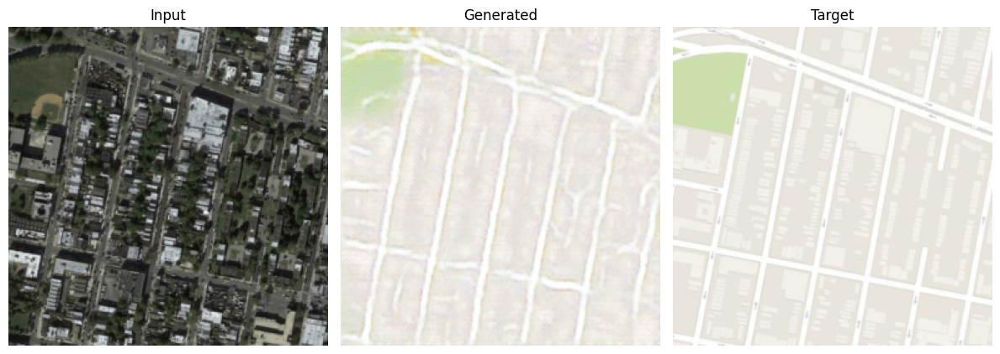

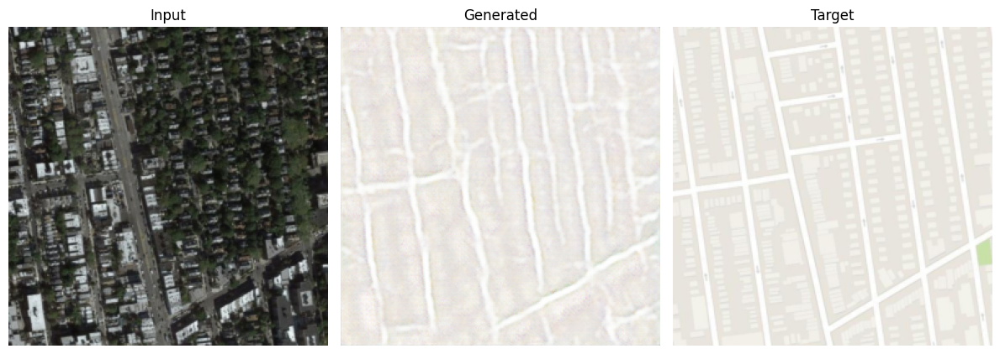

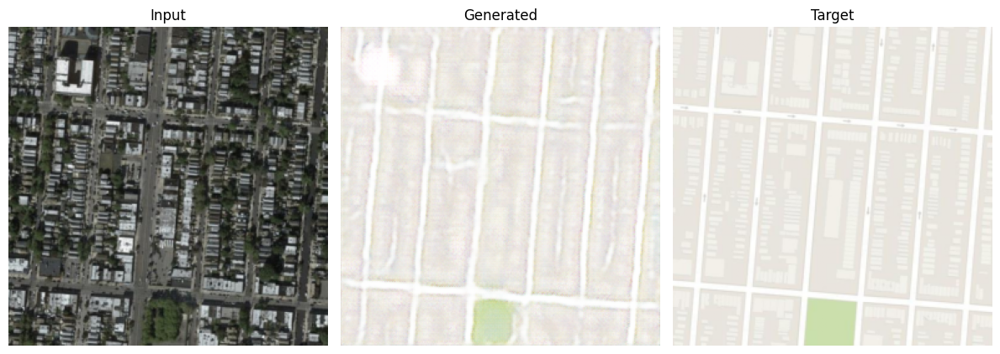

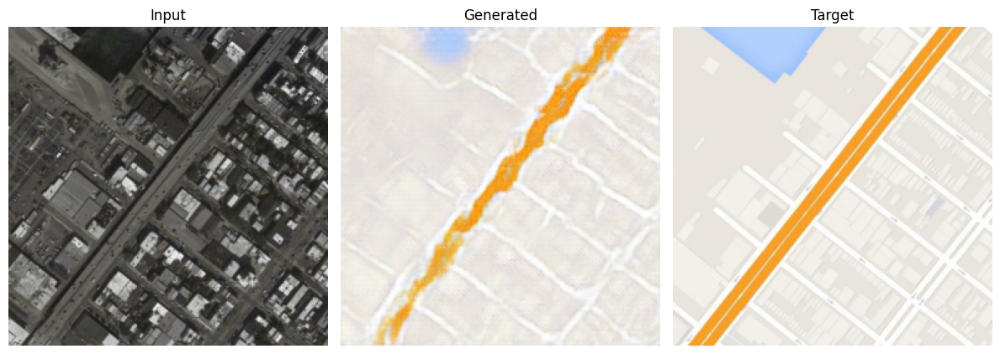

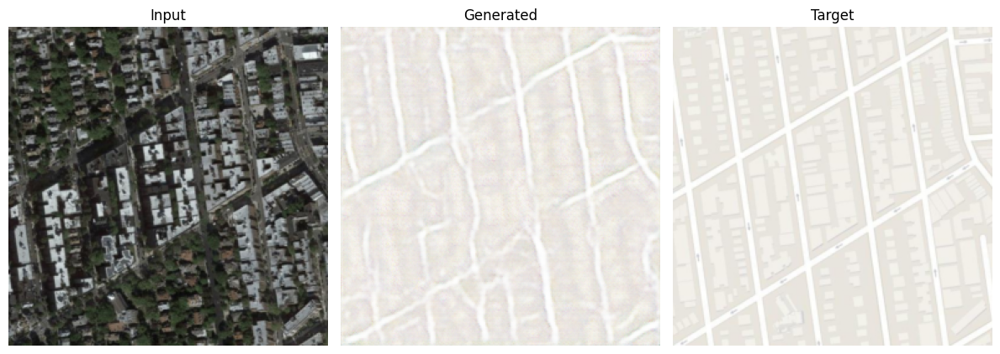

Testing complete.


In [40]:
# Test Pix 2 Pix Adversarial model
test_pix2pix(generator=gen, test_dataset=test_dataset, num_samples=5, save_results=False)

In [41]:
# Evaluate Pix 2 Pix Adversarial model
metrics = evaluate_pix2pix_metrics(generator=gen, test_dataset=test_dataset, num_workers=0, num_samples=1098)
print(metrics)

Evaluation Metrics:
PSNR: 20.2774
SSIM: 0.5181
FID:  370.3135
{'PSNR': 20.277438040422396, 'SSIM': 0.5180926607931898, 'FID': 370.3135451342996}


### Model Trained using VGG perceptual loss and Multi PatchGan Discriminators

Using device: cuda
[Epoch 1/200] [Batch 0/18] D=1.3883 | G=48.5633 | L1=41.4029 | GAN=1.3460 | Perc=5.8144
[Epoch 1/200] [Batch 5/18] D=0.8425 | G=30.4919 | L1=24.5706 | GAN=1.7681 | Perc=4.1532
[Epoch 1/200] [Batch 10/18] D=0.4882 | G=23.5760 | L1=16.4219 | GAN=3.6838 | Perc=3.4703
[Epoch 1/200] [Batch 15/18] D=1.2154 | G=21.1417 | L1=14.6227 | GAN=2.9400 | Perc=3.5789
[Epoch 2/200] [Batch 0/18] D=1.0854 | G=20.3392 | L1=11.7835 | GAN=5.3088 | Perc=3.2469
[Epoch 2/200] [Batch 5/18] D=0.5364 | G=16.1298 | L1=9.2168 | GAN=3.8304 | Perc=3.0826
[Epoch 2/200] [Batch 10/18] D=0.5425 | G=12.8918 | L1=8.1419 | GAN=1.8813 | Perc=2.8686
[Epoch 2/200] [Batch 15/18] D=0.5000 | G=12.0295 | L1=7.6464 | GAN=1.6715 | Perc=2.7115
[Epoch 3/200] [Batch 0/18] D=0.6638 | G=10.9375 | L1=6.6817 | GAN=1.5275 | Perc=2.7284
[Epoch 3/200] [Batch 5/18] D=0.3415 | G=12.2175 | L1=6.7409 | GAN=2.7569 | Perc=2.7197
[Epoch 3/200] [Batch 10/18] D=2.4687 | G=13.2807 | L1=6.8408 | GAN=3.7855 | Perc=2.6544
[Epoch 3/200] 

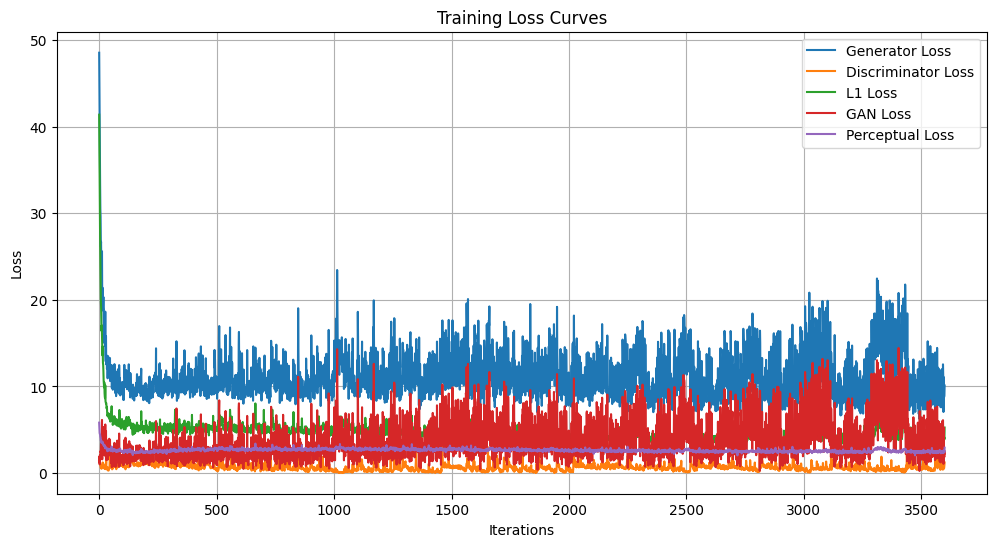

In [42]:
gen = UNetGenerator()
disc = PatchDiscriminator()

# Train VGG Perceptual loss + 2 scale patchGan
train_pix2pix(
    generator=gen,
    discriminator=disc,
    dataset=train_maps_dataset,

    # training schedule
    epochs=200,
    batch_size=64,
    lr=2e-4,
    beta1=0.5,
    beta2=0.999,

    # losses
    lambda_l1=50,
    use_perceptual=True,
    lambda_perc=1.0,

    # discriminator
    use_multiscale_D=True,
    num_scales=2,

    # other defaults
    device=None,
    save_path='pix2pix_checkpoints',
    file_name='maps_vgg_perc_multi_patchgan',
    log_interval=5
)

In [43]:
# Optional: load pre-trained maps generator + discriminator from local checkpoints
gen = UNetGenerator()
disc = PatchDiscriminator()

checkpoint_G = "pix2pix_checkpoints/pix2pix_generator_maps_vgg_perc_multi_patchgan.pth"
checkpoint_D = "pix2pix_checkpoints/pix2pix_discriminator_maps_vgg_perc_multi_patchgan_scale0.pth"

map_loc = 'cuda' if torch.cuda.is_available() else 'cpu'
gen.load_state_dict(torch.load(checkpoint_G, map_location=map_loc))
disc.load_state_dict(torch.load(checkpoint_D, map_location=map_loc))

gen.eval()
disc.eval()

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
gen.to(device)
disc.to(device)

C:\Users\Ragha\AppData\Local\Temp\ipykernel_31340\2795600633.py:9: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  gen.load_state_dict(torch.load(checkpoint_G, map_location=ma

PatchDiscriminator(
  (model): Sequential(
    (0): Conv2d(6, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1))
    (9): LeakyReLU(negative_slope=0.2, inplace=True)
    (10): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), padding=(1, 1))
  )
)

Dataset 'maps' already extracted at datasets\maps
Evaluating Pix2Pix generator...


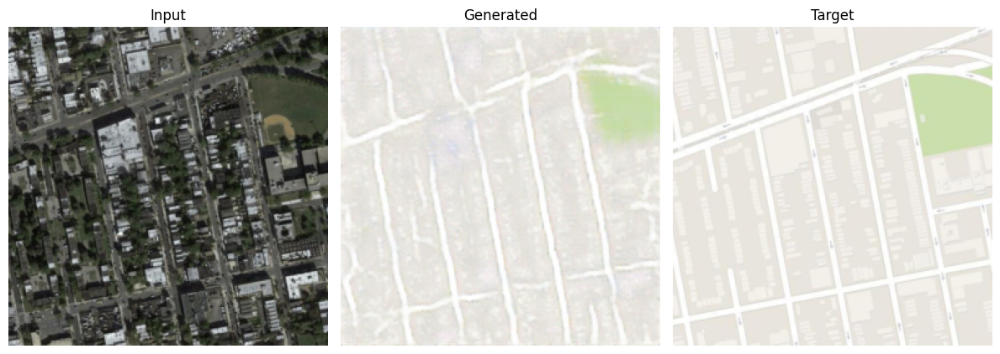

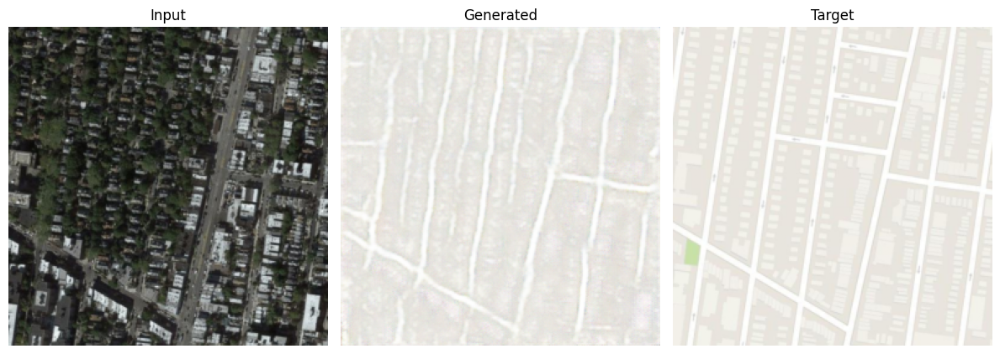

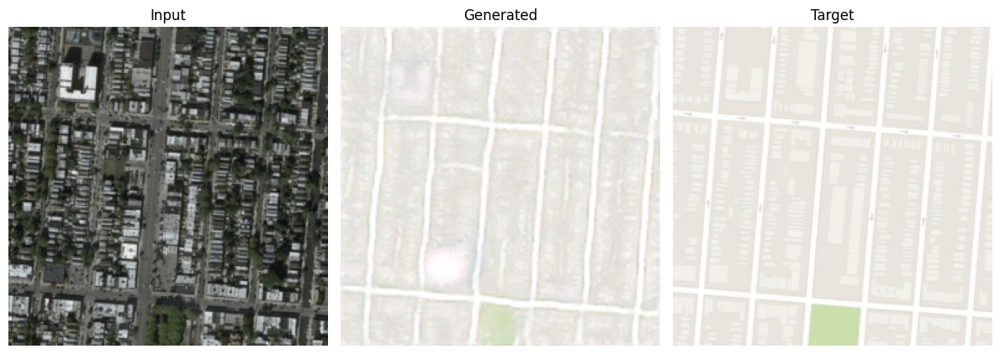

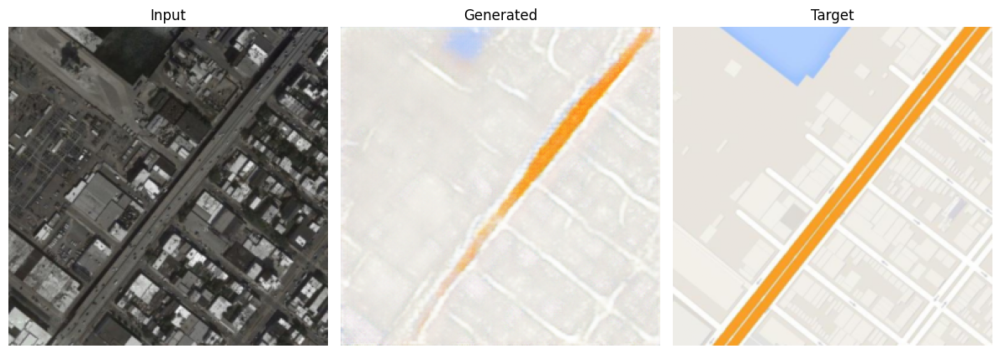

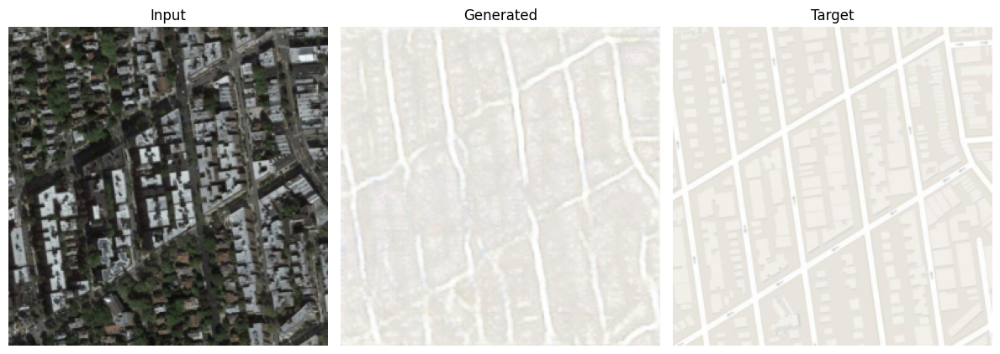

Testing complete.


In [44]:
maps_path = download_pix2pix_dataset("maps")
test_dataset = Pix2PixDataset(maps_path, mode='val')
test_pix2pix(generator=gen, test_dataset=test_dataset, num_samples=5, save_results=False)

In [45]:
## Pix 2 Pix with VGG Perceptual loss and Multi patch gan evaluation
metrics = evaluate_pix2pix_metrics(generator=gen, test_dataset=test_dataset, num_workers=0, num_samples=1098)
print(metrics)

Evaluation Metrics:
PSNR: 20.3304
SSIM: 0.5211
FID:  334.4773
{'PSNR': 20.330365470198334, 'SSIM': 0.5210830065097748, 'FID': 334.477262833683}
